In [1]:
import os
import sys
import glob
import yaml
import pickle
import random
import numpy as np
import pandas as pd
import scipy.stats as stats
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set('talk')
from sklearn import model_selection
from sklearn.preprocessing import StandardScaler, LabelEncoder
import multiprocessing
import scipy.interpolate
import scipy.sparse
from tqdm import tqdm
import sys
sys.path.append('../../')
from src.io_f import read_data_file
from src import compute_f
from scipy.signal import butter, lfilter

In [2]:
delta = pd.read_csv("../exp046/delta_magn.csv")
delta

,site_path_timestamp,x,y,site,path,timestamp,floor_str,sensor_delta_x,sensor_delta_y,delta_x,delta_y
0,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,198.052060,93.971240,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560500995805,F3,0.000000,0.000000,0.000000,0.000000
1,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,180.073350,89.948960,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560501011427,F3,-14.186333,-3.799168,-17.978714,-4.022278
2,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,180.073350,89.948960,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501353313,F3,0.000000,0.000000,0.000000,0.000000
3,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,181.347610,84.303024,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501359897,F3,0.596185,-5.213942,1.274261,-5.645935
4,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,179.019290,79.741630,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501366899,F3,-1.785963,-4.267227,-2.328323,-4.561394
...,...,...,...,...,...,...,...,...,...,...,...
71221,5a0546857ecc773753327266_5e15bf91f4c3420006d52...,49.308346,187.129460,5a0546857ecc773753327266,5e15bf91f4c3420006d52341,1578483574917,B1,-5.293830,2.851582,-5.835197,1.488266
71222,5a0546857ecc773753327266_5e15bf91f4c3420006d52...,42.038810,188.210540,5a0546857ecc773753327266,5e15bf91f4c3420006d52341,1578483580134,B1,-4.928372,2.852852,-7.269535,1.081085
71223,5a0546857ecc773753327266_5e15bf941506f2000638f...,107.938770,148.184360,5a0546857ecc773753327266,5e15bf941506f2000638fec5,1578483469045,B1,0.000000,0.000000,0.000000,0.000000
71224,5a0546857ecc773753327266_5e15bf941506f2000638f...,106.659010,154.629520,5a0546857ecc773753327266,5e15bf941506f2000638fec5,1578483477240,B1,-2.308700,5.061228,-1.279755,6.445160


In [3]:
known_floor = pd.read_csv('../../input/is_known_floor.csv')
known_floor['site'] = known_floor['site_floor'].str.split('_', expand=True)[0]
known_floor['floor_str'] = known_floor['site_floor'].str.split('_', expand=True)[1]
known_floor

,site_floor,is_known_floor,site,floor_str
0,5a0546857ecc773753327266_B1,True,5a0546857ecc773753327266,B1
1,5a0546857ecc773753327266_F1,True,5a0546857ecc773753327266,F1
2,5a0546857ecc773753327266_F2,True,5a0546857ecc773753327266,F2
3,5a0546857ecc773753327266_F3,False,5a0546857ecc773753327266,F3
4,5a0546857ecc773753327266_F4,False,5a0546857ecc773753327266,F4
...,...,...,...,...
132,5dc8cea7659e181adb076a3f_F3,False,5dc8cea7659e181adb076a3f,F3
133,5dc8cea7659e181adb076a3f_F4,False,5dc8cea7659e181adb076a3f,F4
134,5dc8cea7659e181adb076a3f_F5,True,5dc8cea7659e181adb076a3f,F5
135,5dc8cea7659e181adb076a3f_F6,False,5dc8cea7659e181adb076a3f,F6


In [4]:
delta = delta.merge(known_floor, on=['site', 'floor_str'])
delta

,site_path_timestamp,x,y,site,path,timestamp,floor_str,sensor_delta_x,sensor_delta_y,delta_x,delta_y,site_floor,is_known_floor
0,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,198.052060,93.971240,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560500995805,F3,0.000000,0.000000,0.000000,0.000000,5c3c44b80379370013e0fd2b_F3,False
1,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,180.073350,89.948960,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560501011427,F3,-14.186333,-3.799168,-17.978714,-4.022278,5c3c44b80379370013e0fd2b_F3,False
2,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,180.073350,89.948960,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501353313,F3,0.000000,0.000000,0.000000,0.000000,5c3c44b80379370013e0fd2b_F3,False
3,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,181.347610,84.303024,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501359897,F3,0.596185,-5.213942,1.274261,-5.645935,5c3c44b80379370013e0fd2b_F3,False
4,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,179.019290,79.741630,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501366899,F3,-1.785963,-4.267227,-2.328323,-4.561394,5c3c44b80379370013e0fd2b_F3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
71101,5a0546857ecc773753327266_5e15b7161506f2000638f...,106.743450,103.483450,5a0546857ecc773753327266,5e15b7161506f2000638feae,1578481305272,F1,0.000000,0.000000,0.000000,0.000000,5a0546857ecc773753327266_F1,True
71102,5a0546857ecc773753327266_5e15b7161506f2000638f...,101.140920,99.616066,5a0546857ecc773753327266,5e15b7161506f2000638feae,1578481311939,F1,-6.417053,-2.230400,-5.602524,-3.867386,5a0546857ecc773753327266_F1,True
71103,5a0546857ecc773753327266_5e15b7161506f2000638f...,101.833115,95.673080,5a0546857ecc773753327266,5e15b7161506f2000638feae,1578481322715,F1,1.311359,-6.385502,0.692192,-3.942985,5a0546857ecc773753327266_F1,True
71104,5a0546857ecc773753327266_5e15b718f4c3420006d52...,96.389580,112.475685,5a0546857ecc773753327266,5e15b718f4c3420006d52322,1578481256837,F1,0.000000,0.000000,0.000000,0.000000,5a0546857ecc773753327266_F1,True


In [9]:
delta.loc[delta['site']=='5d27075f03f801723c2e360f', 'floor_str'].unique()

array(['F1', 'F2', 'F3', 'F4', 'F5', 'B1'], dtype=object)

Text(0.5, 1.0, 'y = 0.816x-0.0705')

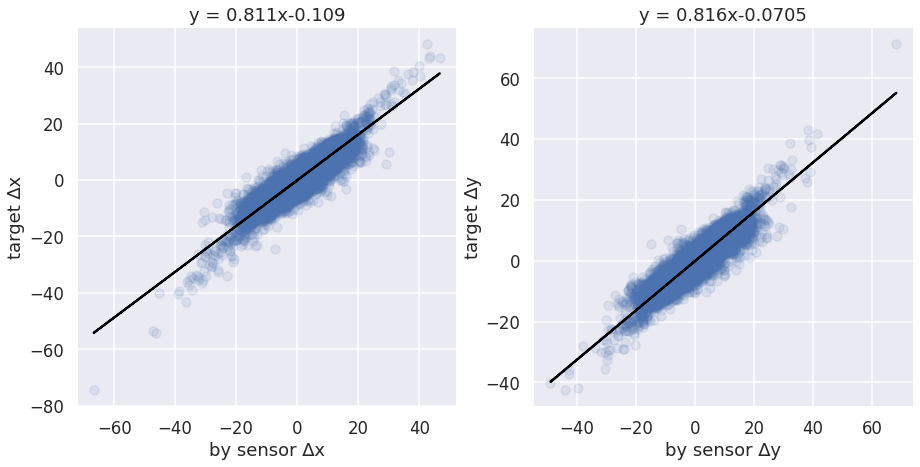

In [20]:
from sklearn import linear_model

target_x = delta["delta_x"].values.reshape(-1,1)
pred_x = delta["sensor_delta_x"].values.reshape(-1,1)
target_y = delta["delta_y"].values.reshape(-1,1)
pred_y = delta["sensor_delta_y"].values.reshape(-1,1)

reg1 = linear_model.LinearRegression()
reg1.fit(pred_x, target_x)

fig = plt.figure(figsize=(15, 7))
ax1 = fig.add_subplot(121)
ax1.plot(pred_x, reg1.predict(pred_x), color='black')
ax1.scatter(pred_x, target_x, alpha=0.1)
ax1.set_xlabel('by sensor ∆x')
ax1.set_ylabel('target ∆x')
ax1.set_title('y = {:.3g}x{:.3g}'.format(reg1.coef_[0][0], reg1.intercept_[0]))

reg2 = linear_model.LinearRegression()
reg2.fit(pred_y, target_y)
ax2 = fig.add_subplot(122)
ax2.plot(pred_y, reg1.predict(pred_y), color='black')
ax2.scatter(pred_y, target_y, alpha=0.1)
ax2.set_xlabel('by sensor ∆y')
ax2.set_ylabel('target ∆y')
ax2.set_title('y = {:.3g}x{:.3g}'.format(reg2.coef_[0][0], reg2.intercept_[0]))
# plt.savefig("delta_all.png")

## siteごとに上の可視化を行なってみる。

In [21]:
site_list = delta['site'].unique()

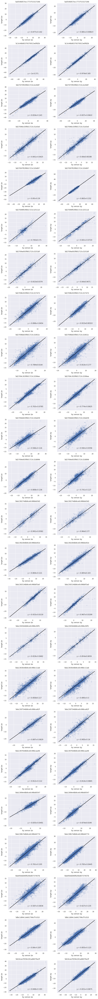

In [18]:
from sklearn import linear_model
delta_x_dict = {}
delta_y_dict = {}
fig = plt.figure(figsize=(10, 100))
sns.set('notebook')
for i, (site, df) in enumerate(delta.groupby('site')):
    target_x = df["delta_x"].values.reshape(-1,1)
    pred_x = df["sensor_delta_x"].values.reshape(-1,1)
    target_y = df["delta_y"].values.reshape(-1,1)
    pred_y = df["sensor_delta_y"].values.reshape(-1,1)
    
    # x
    reg1 = linear_model.LinearRegression()
    reg1.fit(pred_x, target_x)

    ax = fig.add_subplot(24, 2, 2*(i+1)-1)
    ax.plot(pred_x, reg1.predict(pred_x), color='black')
    ax.scatter(pred_x, target_x, alpha=0.1)
    ax.set_xlabel('by sensor ∆x')
    ax.set_ylabel('target ∆x')
    plt.text(0.5,0.1, 'y = {:.3g}x{:.3g}'.format(reg1.coef_[0][0], reg1.intercept_[0]),transform=ax.transAxes)
    ax.set_title('{}'.format(site))
    delta_x_dict[site] = round(reg1.coef_[0][0], 3)
    
    # y
    reg2 = linear_model.LinearRegression()
    reg2.fit(pred_y, target_y)
    ax = fig.add_subplot(24,2,2*(i+1))
    ax.plot(pred_y, reg1.predict(pred_y), color='black')
    ax.scatter(pred_y, target_y, alpha=0.1)
    ax.set_xlabel('by sensor ∆y')
    ax.set_ylabel('target ∆y')
    plt.text(0.5,0.1, 'y = {:.3g}x{:.3g}'.format(reg2.coef_[0][0], reg2.intercept_[0]),transform=ax.transAxes)
    ax.set_title('{}'.format(site))
    delta_y_dict[site] = round(reg2.coef_[0][0], 3)
plt.tight_layout()
plt.savefig("delta_magn_site.png")

## site-floorごとに可視化を行なってみる

In [22]:
site_list

array(['5c3c44b80379370013e0fd2b', '5a0546857ecc773753327266',
       '5d2709a003f801723c3251bf', '5da1382d4db8ce0c98bbe92e',
       '5da138314db8ce0c98bbf3a0', '5d27075f03f801723c2e360f',
       '5d2709b303f801723c327472', '5da138764db8ce0c98bcaa46',
       '5da958dd46f8266d0737457b', '5d2709c303f801723c3299ee',
       '5da138364db8ce0c98bc00f1', '5d27096c03f801723c31e5e0',
       '5da138b74db8ce0c98bd4774', '5d27099f03f801723c32511d',
       '5da1389e4db8ce0c98bd0547', '5da138274db8ce0c98bbd3d2',
       '5d2709d403f801723c32bd39', '5d2709e003f801723c32d896',
       '5d2709bb03f801723c32852c', '5dc8cea7659e181adb076a3f',
       '5da138754db8ce0c98bca82f', '5d27097f03f801723c320d97',
       '5da1383b4db8ce0c98bc11ab', '5dbc1d84c1eb61796cf7c010'],
      dtype=object)

In [23]:
delta[delta['site'] == site_list[0]]

,site_path_timestamp,x,y,site,path,timestamp,floor_str,sensor_delta_x,sensor_delta_y,delta_x,delta_y,site_floor,is_known_floor
0,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,198.05206,93.971240,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560500995805,F3,0.000000,0.000000,0.000000,0.000000,5c3c44b80379370013e0fd2b_F3,False
1,5c3c44b80379370013e0fd2b_5d073b814a19c000086c5...,180.07335,89.948960,5c3c44b80379370013e0fd2b,5d073b814a19c000086c558b,1560501011427,F3,-14.186333,-3.799168,-17.978714,-4.022278,5c3c44b80379370013e0fd2b_F3,False
2,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,180.07335,89.948960,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501353313,F3,0.000000,0.000000,0.000000,0.000000,5c3c44b80379370013e0fd2b_F3,False
3,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,181.34761,84.303024,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501359897,F3,0.596185,-5.213942,1.274261,-5.645935,5c3c44b80379370013e0fd2b_F3,False
4,5c3c44b80379370013e0fd2b_5d073b821a69370008bc5...,179.01929,79.741630,5c3c44b80379370013e0fd2b,5d073b821a69370008bc5cf8,1560501366899,F3,-1.785963,-4.267227,-2.328323,-4.561394,5c3c44b80379370013e0fd2b_F3,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1682,5c3c44b80379370013e0fd2b_5d8dbc14b3042e000612f...,189.25055,126.978386,5c3c44b80379370013e0fd2b,5d8dbc14b3042e000612f8bf,1569569777026,F5,5.836466,3.303787,5.923187,3.922318,5c3c44b80379370013e0fd2b_F5,False
1683,5c3c44b80379370013e0fd2b_5d8dbc14b3042e000612f...,195.99740,129.976940,5c3c44b80379370013e0fd2b,5d8dbc14b3042e000612f8bf,1569569782678,F5,5.432089,-0.094686,6.746857,2.998558,5c3c44b80379370013e0fd2b_F5,False
1684,5c3c44b80379370013e0fd2b_5d8dbc14fc794e0006ec2...,193.10172,131.336440,5c3c44b80379370013e0fd2b,5d8dbc14fc794e0006ec20a6,1569569788731,F5,0.000000,0.000000,0.000000,0.000000,5c3c44b80379370013e0fd2b_F5,False
1685,5c3c44b80379370013e0fd2b_5d8dbc14fc794e0006ec2...,190.18886,124.585180,5c3c44b80379370013e0fd2b,5d8dbc14fc794e0006ec20a6,1569569796261,F5,-1.740024,-6.520335,-2.912857,-6.751259,5c3c44b80379370013e0fd2b_F5,False


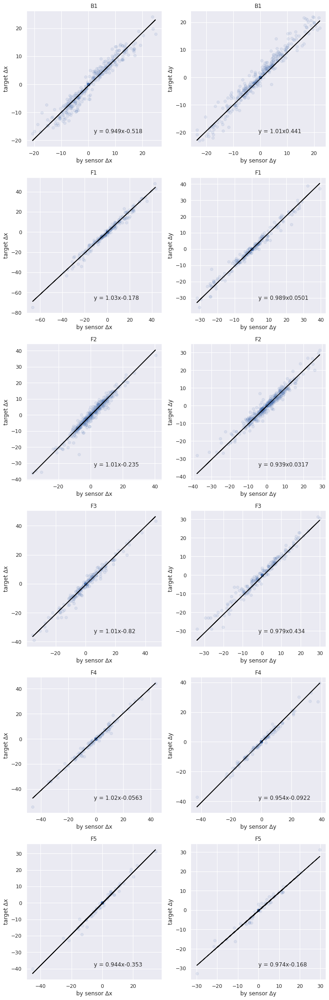

In [30]:
from sklearn import linear_model
delta_x_dict = {}
delta_y_dict = {}
site = site_list[0]
delta_site_df = delta[delta['site'] == site]
num_floor = delta_site_df['floor_str'].nunique()
fig = plt.figure(figsize=(10, 5*num_floor))
sns.set('notebook')

for i, (floor, df) in enumerate(delta_site_df.groupby('floor_str')):
    target_x = df["delta_x"].values.reshape(-1,1)
    pred_x = df["sensor_delta_x"].values.reshape(-1,1)
    target_y = df["delta_y"].values.reshape(-1,1)
    pred_y = df["sensor_delta_y"].values.reshape(-1,1)
    
    # x
    reg1 = linear_model.LinearRegression()
    reg1.fit(pred_x, target_x)

    ax = fig.add_subplot(num_floor, 2, 2*(i+1)-1)
    ax.plot(pred_x, reg1.predict(pred_x), color='black')
    ax.scatter(pred_x, target_x, alpha=0.1)
    ax.set_xlabel('by sensor ∆x')
    ax.set_ylabel('target ∆x')
    plt.text(0.5,0.1, 'y = {:.3g}x{:.3g}'.format(reg1.coef_[0][0], reg1.intercept_[0]),transform=ax.transAxes)
    ax.set_title('{}'.format(floor))
    delta_x_dict[site] = round(reg1.coef_[0][0], 3)
    
    # y
    reg2 = linear_model.LinearRegression()
    reg2.fit(pred_y, target_y)
    ax = fig.add_subplot(num_floor, 2, 2*(i+1))
    ax.plot(pred_y, reg1.predict(pred_y), color='black')
    ax.scatter(pred_y, target_y, alpha=0.1)
    ax.set_xlabel('by sensor ∆y')
    ax.set_ylabel('target ∆y')
    plt.text(0.5,0.1, 'y = {:.3g}x{:.3g}'.format(reg2.coef_[0][0], reg2.intercept_[0]),transform=ax.transAxes)
    ax.set_title('{}'.format(floor))
    delta_y_dict[site] = round(reg2.coef_[0][0], 3)
plt.tight_layout()
plt.savefig("delta_magn_site_floor.png")

In [33]:
from sklearn import linear_model
delta_x_dict = {}
delta_y_dict = {}

for site in site_list:

    delta_site_df = delta[delta['site'] == site]

    for floor, df in delta_site_df.groupby('floor_str'):
        target_x = df["delta_x"].values.reshape(-1,1)
        pred_x = df["sensor_delta_x"].values.reshape(-1,1)
        target_y = df["delta_y"].values.reshape(-1,1)
        pred_y = df["sensor_delta_y"].values.reshape(-1,1)
        
        # x
        reg1 = linear_model.LinearRegression()
        reg1.fit(pred_x, target_x)
        delta_x_dict[f'{site}-{floor}'] = round(reg1.coef_[0][0], 3)
        
        # y
        reg2 = linear_model.LinearRegression()
        reg2.fit(pred_y, target_y)
        delta_y_dict[f'{site}-{floor}'] = round(reg2.coef_[0][0], 3)

In [35]:
def pickle_dump(obj, path):
    with open(path, mode='wb') as f:
        pickle.dump(obj,f)

def pickle_load(path):
    with open(path, mode='rb') as f:
        data = pickle.load(f)
        return data

In [20]:
pickle_dump(delta_x_dict, 'delta_magn_x_coeff_floor.pkl')
pickle_dump(delta_y_dict, 'delta_magn_y_coeff_floor.pkl')